In [1]:
from utils import *

# Mouse differences

In [2]:
data_game = pd.read_csv(os.path.join('..', 'data', 'processed', 'minigame_aggregated_data.csv'), delimiter=';')
data_points = pd.read_csv(os.path.join('..', 'data', 'processed', 'points_aggregated_data.csv'), delimiter=';')
data_prot = pd.read_csv(os.path.join('..', 'data', 'processed', 'prototype_aggregated_data.csv'), delimiter=';')
data_points = data_points[(data_points.respondent_id != 7) & (data_points.respondent_id != 15)]

data_all = pd.concat([data_points, data_prot, data_game], ignore_index=True)
data_all = data_all.sort_values(['respondent_id', 'session_id'])

In [3]:
sensitivity_settings = ['DPI2400_SENS5', 'DPI2400_SENS10', 'DPI2400_SENS18']
dpi_settings = ['DPI1000_SENS10', 'DPI2400_SENS10', 'DPI4800_SENS10']

data_all['setting_string'] = ''
data_all.loc[(data_all.dpi==1000) & (data_all.sens==10), 'setting_string'] = 'DPI1000_SENS10'
data_all.loc[(data_all.dpi==2400) & (data_all.sens==5), 'setting_string'] = 'DPI2400_SENS5'
data_all.loc[(data_all.dpi==2400) & (data_all.sens==18), 'setting_string'] = 'DPI2400_SENS18'
data_all.loc[(data_all.dpi==2400) & (data_all.sens==10), 'setting_string'] = 'DPI2400_SENS10'
data_all.loc[(data_all.dpi==4800) & (data_all.sens==10), 'setting_string'] = 'DPI4800_SENS10'

In [4]:
columns = list(filter(lambda x: x not in (useless_columns + filter_columns + ['dpi', 'sens']), list(data_all.columns)))

## Normal distribution check

In [5]:
my_shapiro(data_all, columns)

2/108 normally distributed metrics.


In [6]:
for setting in set().union(*[sensitivity_settings, dpi_settings]):
    print(setting + ': ', end='')
    my_shapiro(data_all[data_all.setting_string == setting], columns)

DPI1000_SENS10: 6/108 normally distributed metrics.
DPI4800_SENS10: 8/108 normally distributed metrics.
DPI2400_SENS10: 10/108 normally distributed metrics.
DPI2400_SENS18: 6/108 normally distributed metrics.
DPI2400_SENS5: 8/108 normally distributed metrics.


## Mouse differences - minigame

In [7]:
data = data_all[data_all['game_number'] == data_all['game_number']]

### Impact of sensitivity

In [8]:
results_temp = my_friedman(data, columns, 'setting_string', sensitivity_settings)
results_temp.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI2400_SENS5__DPI2400_SENS10,DPI2400_SENS5__DPI2400_SENS18,DPI2400_SENS10__DPI2400_SENS18
62,acceleration_positive_median,< .001,102.6500,0.53,True,< .001,< .001,< .001
61,acceleration_positive_mean,< .001,96.3300,0.5,True,< .001,< .001,< .001
51,acceleration_y_q95,< .001,88.0800,0.46,True,< .001,< .001,< .001
70,acceleration_negative_median,< .001,81.7700,0.43,True,< .001,< .001,< .001
55,acceleration_y_std,< .001,66.9000,0.35,True,< .001,< .001,0.001
25,distance_median,< .001,64.1600,0.33,True,< .001,< .001,< .001
60,acceleration_positive_mean_weighted,< .001,61.0000,0.32,True,< .001,< .001,0.002
52,acceleration_y_q5,< .001,60.3800,0.31,True,< .001,< .001,< .001
2,velocity_max,< .001,56.9000,0.3,True,< .001,< .001,0.005
36,acceleration_q95,< .001,56.5800,0.29,True,< .001,< .001,0.003


In [9]:
results_temp.significant.value_counts()

significant
True     72
False    36
Name: count, dtype: int64

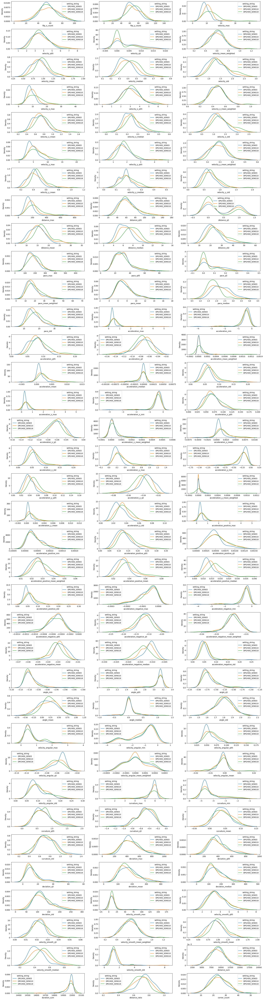

In [10]:
my_kdeplot(data[(data['setting_string'] != 'DPI1000_SENS10') & (data['setting_string'] != 'DPI4800_SENS10')], columns, 'setting_string')

### Impact of DPI

In [11]:
results_temp = my_friedman(data, columns, 'setting_string', dpi_settings)
results_temp.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI4800_SENS10
70,acceleration_negative_median,< .001,107.6500,0.56,True,0.9,< .001,< .001
62,acceleration_positive_median,< .001,88.5200,0.46,True,0.017,< .001,< .001
52,acceleration_y_q5,< .001,79.7300,0.42,True,0.012,< .001,< .001
37,acceleration_q5,< .001,68.5800,0.36,True,0.731,< .001,< .001
45,acceleration_x_q5,< .001,65.8600,0.34,True,0.669,< .001,< .001
69,acceleration_negative_mean,< .001,64.5200,0.34,True,0.031,< .001,< .001
68,acceleration_negative_mean_weighted,< .001,61.4000,0.32,True,0.482,< .001,< .001
106,distance_ratio,< .001,51.8100,0.27,True,< .001,< .001,0.014
23,distance_q5,< .001,45.7200,0.24,True,0.586,< .001,< .001
102,velocity_smooth_median,< .001,43.9400,0.23,True,0.397,< .001,< .001


In [12]:
results_temp.significant.value_counts()

significant
True     82
False    26
Name: count, dtype: int64

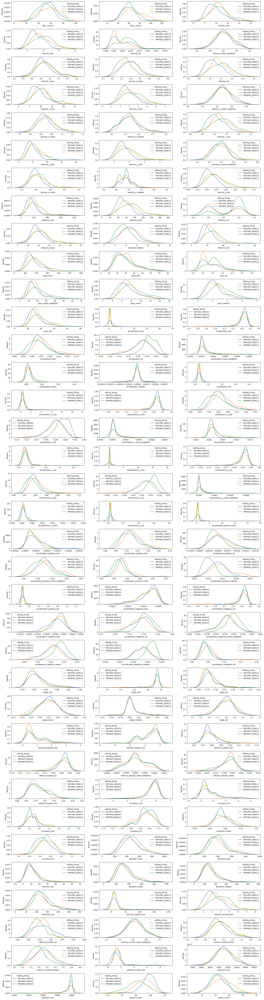

In [13]:
my_kdeplot(data[(data['setting_string'] != 'DPI2400_SENS5') & (data['setting_string'] != 'DPI2400_SENS18')], columns, 'setting_string')

# Mouse differences - points task

In [14]:
data = data_all[data_all['task_id'] == data_all['task_id']]

## Impact of sensitivity

In [15]:
results_points_sens = my_friedman(data, columns, 'setting_string', sensitivity_settings)
results_points_sens.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI2400_SENS5__DPI2400_SENS10,DPI2400_SENS5__DPI2400_SENS18,DPI2400_SENS10__DPI2400_SENS18
62,acceleration_positive_median,< .001,150.8100,0.42,True,< .001,< .001,< .001
61,acceleration_positive_mean,< .001,133.3000,0.37,True,< .001,< .001,< .001
2,velocity_max,< .001,115.8800,0.32,True,< .001,< .001,< .001
70,acceleration_negative_median,< .001,115.1400,0.32,True,< .001,< .001,< .001
47,acceleration_x_mean,< .001,112.3000,0.31,True,< .001,< .001,< .001
102,velocity_smooth_median,< .001,110.5300,0.31,True,< .001,< .001,< .001
39,acceleration_mean,< .001,107.0300,0.3,True,< .001,< .001,< .001
32,pace_median,< .001,103.0800,0.29,True,< .001,< .001,< .001
60,acceleration_positive_mean_weighted,< .001,97.3400,0.27,True,< .001,< .001,< .001
9,velocity_x_max,< .001,94.0200,0.26,True,< .001,< .001,< .001


In [16]:
display(HTML(results_points_sens.sort_values('Q', ascending=False).to_html()))

,Feature name,p,Q,effsize,significant,DPI2400_SENS5__DPI2400_SENS10,DPI2400_SENS5__DPI2400_SENS18,DPI2400_SENS10__DPI2400_SENS18
62,acceleration_positive_median,< .001,150.8100,0.42,True,< .001,< .001,< .001
61,acceleration_positive_mean,< .001,133.3000,0.37,True,< .001,< .001,< .001
2,velocity_max,< .001,115.8800,0.32,True,< .001,< .001,< .001
70,acceleration_negative_median,< .001,115.1400,0.32,True,< .001,< .001,< .001
47,acceleration_x_mean,< .001,112.3000,0.31,True,< .001,< .001,< .001
102,velocity_smooth_median,< .001,110.5300,0.31,True,< .001,< .001,< .001
39,acceleration_mean,< .001,107.0300,0.3,True,< .001,< .001,< .001
32,pace_median,< .001,103.0800,0.29,True,< .001,< .001,< .001
60,acceleration_positive_mean_weighted,< .001,97.3400,0.27,True,< .001,< .001,< .001
9,velocity_x_max,< .001,94.0200,0.26,True,< .001,< .001,< .001


In [17]:
significant = results_points_sens['Feature name'].values
for prefix in ['velocity', 'acceleration', 'flip', 'pace', 'angle', 'curvature', 'deviation', 'distance', 'duration', 'corner']:
    features = [x for x in significant if x.startswith(prefix)]
    print(prefix, len(features))

velocity 33
acceleration 38
flip 2
pace 7
angle 6
curvature 6
deviation 6
distance 8
duration 1
corner 1


In [18]:
results_points_sens.significant.value_counts()

significant
True     83
False    25
Name: count, dtype: int64

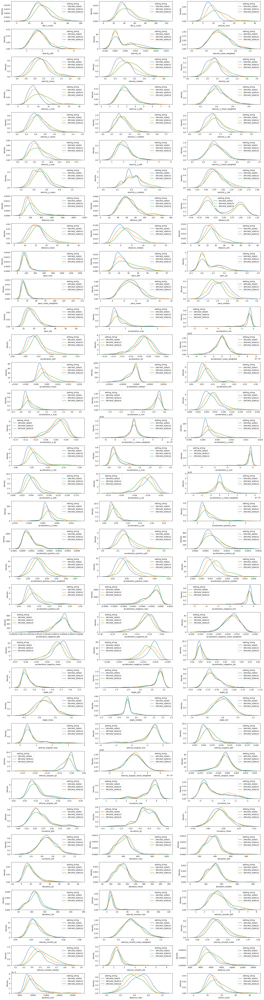

In [19]:
my_kdeplot(data[(data['setting_string'] != 'DPI1000_SENS10') & (data['setting_string'] != 'DPI4800_SENS10')], columns, 'setting_string')

## Impact of DPI

In [20]:
results_points_dpi = my_friedman(data, columns, 'setting_string', dpi_settings)
results_points_dpi.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI4800_SENS10
62,acceleration_positive_median,< .001,208.2100,0.58,True,< .001,< .001,< .001
70,acceleration_negative_median,< .001,207.7400,0.58,True,0.278,< .001,< .001
61,acceleration_positive_mean,< .001,178.0100,0.49,True,< .001,< .001,< .001
37,acceleration_q5,< .001,174.9800,0.49,True,0.303,< .001,< .001
105,duration_sum,< .001,169.8800,0.47,True,< .001,< .001,< .001
45,acceleration_x_q5,< .001,161.8100,0.45,True,0.631,< .001,< .001
52,acceleration_y_q5,< .001,150.8300,0.42,True,0.004,< .001,< .001
68,acceleration_negative_mean_weighted,< .001,149.2100,0.41,True,0.112,< .001,< .001
69,acceleration_negative_mean,< .001,138.0100,0.38,True,0.014,< .001,< .001
44,acceleration_x_q95,< .001,136.9000,0.38,True,< .001,< .001,< .001


In [21]:
display(HTML(results_points_dpi.sort_values('Q', ascending=False).to_html()))

,Feature name,p,Q,effsize,significant,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI4800_SENS10
62,acceleration_positive_median,< .001,208.2100,0.58,True,< .001,< .001,< .001
70,acceleration_negative_median,< .001,207.7400,0.58,True,0.278,< .001,< .001
61,acceleration_positive_mean,< .001,178.0100,0.49,True,< .001,< .001,< .001
37,acceleration_q5,< .001,174.9800,0.49,True,0.303,< .001,< .001
105,duration_sum,< .001,169.8800,0.47,True,< .001,< .001,< .001
45,acceleration_x_q5,< .001,161.8100,0.45,True,0.631,< .001,< .001
52,acceleration_y_q5,< .001,150.8300,0.42,True,0.004,< .001,< .001
68,acceleration_negative_mean_weighted,< .001,149.2100,0.41,True,0.112,< .001,< .001
69,acceleration_negative_mean,< .001,138.0100,0.38,True,0.014,< .001,< .001
44,acceleration_x_q95,< .001,136.9000,0.38,True,< .001,< .001,< .001


In [22]:
significant = results_points_dpi['Feature name'].values
for prefix in ['velocity', 'acceleration', 'flip', 'pace', 'angle', 'curvature', 'deviation', 'distance', 'duration', 'corner']:
    features = [x for x in significant if x.startswith(prefix)]
    print(prefix, len(features))

velocity 33
acceleration 38
flip 2
pace 7
angle 6
curvature 6
deviation 6
distance 8
duration 1
corner 1


In [23]:
results_points_dpi.significant.value_counts()

significant
True     89
False    19
Name: count, dtype: int64

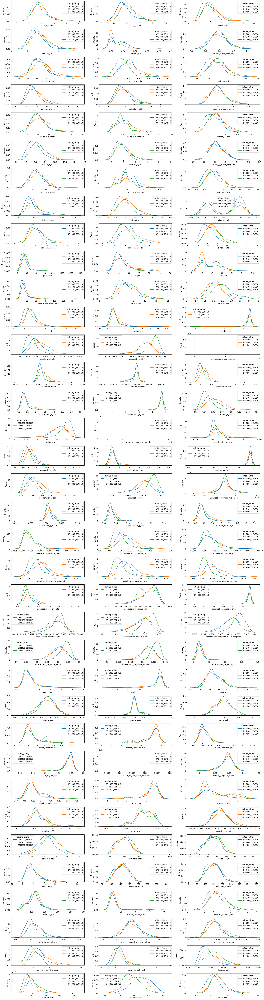

In [24]:
my_kdeplot(data[(data['setting_string'] != 'DPI2400_SENS5') & (data['setting_string'] != 'DPI2400_SENS18')], columns, 'setting_string')

# Mouse differences - prototype task

In [25]:
data = data_all[data_all['prototype_id'] == data_all['prototype_id']]

## Impact of sensitivity

In [26]:
results_prot_sens = my_friedman(data, columns, 'setting_string', sensitivity_settings)
results_prot_sens.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI2400_SENS5__DPI2400_SENS10,DPI2400_SENS5__DPI2400_SENS18,DPI2400_SENS10__DPI2400_SENS18
37,acceleration_q5,< .001,37.5600,0.59,True,0.003,< .001,0.011
36,acceleration_q95,< .001,36.1900,0.57,True,0.002,< .001,0.024
52,acceleration_y_q5,< .001,36.1900,0.57,True,0.024,< .001,0.002
58,acceleration_positive_q95,< .001,35.6900,0.56,True,< .001,< .001,0.112
69,acceleration_negative_mean,< .001,34.5600,0.54,True,0.016,< .001,0.005
51,acceleration_y_q95,< .001,33.8100,0.53,True,< .001,< .001,0.085
97,velocity_smooth_max,< .001,33.2500,0.52,True,0.033,< .001,0.003
61,acceleration_positive_mean,< .001,33.0600,0.52,True,0.011,< .001,0.011
41,acceleration_std,< .001,31.6900,0.5,True,0.024,< .001,0.008
44,acceleration_x_q95,< .001,30.4400,0.48,True,0.046,< .001,0.005


In [27]:
display(HTML(results_prot_sens.sort_values('Q', ascending=False).to_html()))

,Feature name,p,Q,effsize,significant,DPI2400_SENS5__DPI2400_SENS10,DPI2400_SENS5__DPI2400_SENS18,DPI2400_SENS10__DPI2400_SENS18
37,acceleration_q5,< .001,37.5600,0.59,True,0.003,< .001,0.011
36,acceleration_q95,< .001,36.1900,0.57,True,0.002,< .001,0.024
52,acceleration_y_q5,< .001,36.1900,0.57,True,0.024,< .001,0.002
58,acceleration_positive_q95,< .001,35.6900,0.56,True,< .001,< .001,0.112
69,acceleration_negative_mean,< .001,34.5600,0.54,True,0.016,< .001,0.005
51,acceleration_y_q95,< .001,33.8100,0.53,True,< .001,< .001,0.085
97,velocity_smooth_max,< .001,33.2500,0.52,True,0.033,< .001,0.003
61,acceleration_positive_mean,< .001,33.0600,0.52,True,0.011,< .001,0.011
41,acceleration_std,< .001,31.6900,0.5,True,0.024,< .001,0.008
44,acceleration_x_q95,< .001,30.4400,0.48,True,0.046,< .001,0.005


In [28]:
results_prot_sens.significant.value_counts()

significant
True     73
False    35
Name: count, dtype: int64

In [29]:
significant = results_prot_sens['Feature name'].values
for prefix in ['velocity', 'acceleration', 'flip', 'pace', 'angle', 'curvature', 'deviation', 'distance', 'duration', 'corner']:
    features = [x for x in significant if x.startswith(prefix)]
    print(prefix, len(features))

velocity 33
acceleration 38
flip 2
pace 7
angle 6
curvature 6
deviation 6
distance 8
duration 1
corner 1


c:\Users\mkrajcovic\Desktop\mouse\analysis\scripts\utils.py:127: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


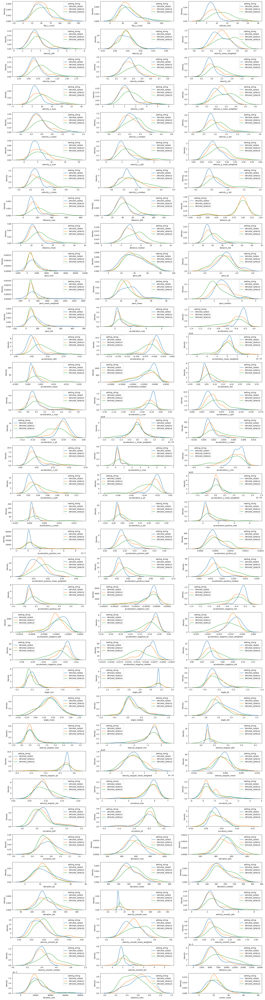

In [30]:
my_kdeplot(data[(data['setting_string'] != 'DPI1000_SENS10') & (data['setting_string'] != 'DPI4800_SENS10')], columns, 'setting_string')

## Impact of DPI

In [32]:
results_prot_dpi = my_friedman(data, columns, 'setting_string', dpi_settings)
results_prot_dpi.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI4800_SENS10
39,acceleration_mean,< .001,34.3100,0.54,True,< .001,0.9,< .001
58,acceleration_positive_q95,< .001,33.2500,0.52,True,< .001,0.426,< .001
61,acceleration_positive_mean,< .001,32.2500,0.5,True,< .001,0.714,< .001
54,acceleration_y_mean,< .001,31.9400,0.5,True,< .001,0.235,< .001
36,acceleration_q95,< .001,31.9400,0.5,True,< .001,0.235,< .001
70,acceleration_negative_median,< .001,31.6900,0.5,True,0.024,0.008,< .001
26,distance_std,< .001,30.0600,0.47,True,< .001,< .001,0.187
40,acceleration_median,< .001,29.1100,0.45,True,0.001,0.822,< .001
103,velocity_smooth_std,< .001,28.5600,0.45,True,< .001,< .001,0.426
62,acceleration_positive_median,< .001,28.3100,0.44,True,0.002,0.146,< .001


In [33]:
display(HTML(results_prot_dpi.sort_values('Q', ascending=False).to_html()))

,Feature name,p,Q,effsize,significant,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI4800_SENS10
39,acceleration_mean,< .001,34.3100,0.54,True,< .001,0.9,< .001
58,acceleration_positive_q95,< .001,33.2500,0.52,True,< .001,0.426,< .001
61,acceleration_positive_mean,< .001,32.2500,0.5,True,< .001,0.714,< .001
54,acceleration_y_mean,< .001,31.9400,0.5,True,< .001,0.235,< .001
36,acceleration_q95,< .001,31.9400,0.5,True,< .001,0.235,< .001
70,acceleration_negative_median,< .001,31.6900,0.5,True,0.024,0.008,< .001
26,distance_std,< .001,30.0600,0.47,True,< .001,< .001,0.187
40,acceleration_median,< .001,29.1100,0.45,True,0.001,0.822,< .001
103,velocity_smooth_std,< .001,28.5600,0.45,True,< .001,< .001,0.426
62,acceleration_positive_median,< .001,28.3100,0.44,True,0.002,0.146,< .001


In [34]:
results_prot_dpi.significant.value_counts()

significant
True     76
False    32
Name: count, dtype: int64

In [35]:
significant = results_prot_dpi['Feature name'].values
for prefix in ['velocity', 'acceleration', 'flip', 'pace', 'angle', 'curvature', 'deviation', 'distance', 'duration', 'corner']:
    features = [x for x in significant if x.startswith(prefix)]
    print(prefix, len(features))

velocity 33
acceleration 38
flip 2
pace 7
angle 6
curvature 6
deviation 6
distance 8
duration 1
corner 1


c:\Users\mkrajcovic\Desktop\mouse\analysis\scripts\utils.py:127: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


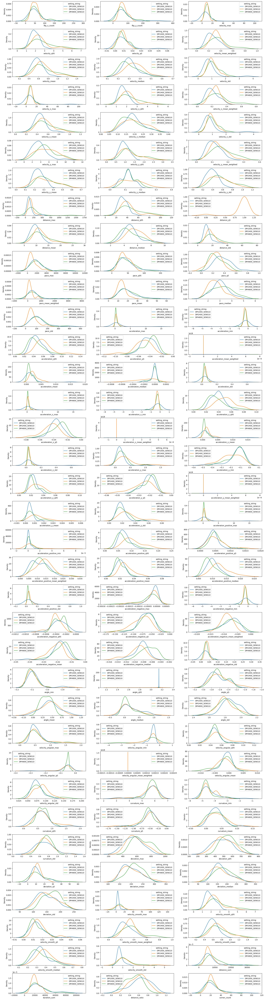

In [36]:
my_kdeplot(data[(data['setting_string'] != 'DPI2400_SENS5') & (data['setting_string'] != 'DPI2400_SENS18')], columns, 'setting_string')

## Mouse differences - all tasks

### Sensitivity

In [37]:
results_temp = my_friedman(data_all, columns, 'setting_string', sensitivity_settings)
results_temp.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI2400_SENS5__DPI2400_SENS10,DPI2400_SENS5__DPI2400_SENS18,DPI2400_SENS10__DPI2400_SENS18
62,acceleration_positive_median,< .001,282.3300,0.46,True,< .001,< .001,< .001
61,acceleration_positive_mean,< .001,261.0800,0.42,True,< .001,< .001,< .001
70,acceleration_negative_median,< .001,223.4900,0.36,True,< .001,< .001,< .001
51,acceleration_y_q95,< .001,209.2300,0.34,True,< .001,< .001,< .001
2,velocity_max,< .001,199.8200,0.32,True,< .001,< .001,< .001
60,acceleration_positive_mean_weighted,< .001,182.2300,0.3,True,< .001,< .001,< .001
36,acceleration_q95,< .001,177.1000,0.29,True,< .001,< .001,< .001
102,velocity_smooth_median,< .001,175.1400,0.28,True,< .001,< .001,< .001
32,pace_median,< .001,173.9800,0.28,True,< .001,< .001,< .001
69,acceleration_negative_mean,< .001,170.4400,0.28,True,< .001,< .001,< .001


In [38]:
results_temp.significant.value_counts()

significant
True     85
False    23
Name: count, dtype: int64

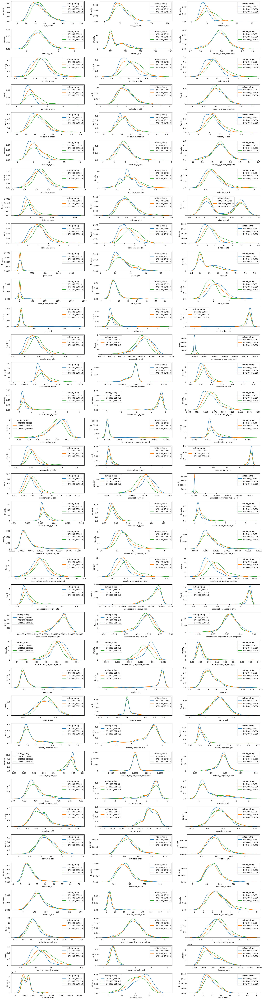

In [39]:
my_kdeplot(data_all[(data_all['setting_string'] != 'DPI1000_SENS10') & (data_all['setting_string'] != 'DPI4800_SENS10')], columns, 'setting_string')

### DPI

In [40]:
results_temp = my_friedman(data_all, columns, 'setting_string', dpi_settings)
results_temp.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI4800_SENS10
70,acceleration_negative_median,< .001,341.0800,0.55,True,0.099,< .001,< .001
62,acceleration_positive_median,< .001,320.4000,0.52,True,< .001,< .001,< .001
37,acceleration_q5,< .001,263.0900,0.43,True,0.051,< .001,< .001
52,acceleration_y_q5,< .001,246.5100,0.4,True,< .001,< .001,< .001
45,acceleration_x_q5,< .001,241.6300,0.39,True,0.079,< .001,< .001
61,acceleration_positive_mean,< .001,240.2800,0.39,True,< .001,< .001,< .001
69,acceleration_negative_mean,< .001,215.3400,0.35,True,< .001,< .001,< .001
68,acceleration_negative_mean_weighted,< .001,205.2700,0.33,True,0.241,< .001,< .001
44,acceleration_x_q95,< .001,193.3500,0.31,True,< .001,< .001,< .001
36,acceleration_q95,< .001,189.1400,0.31,True,< .001,< .001,< .001


In [41]:
results_temp.significant.value_counts()

significant
True     95
False    13
Name: count, dtype: int64

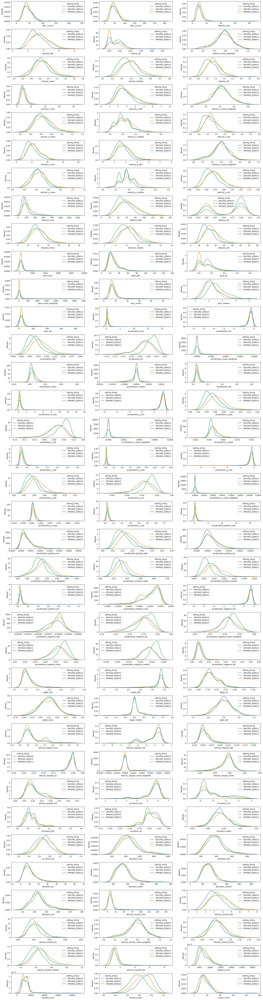

In [42]:
my_kdeplot(data_all[(data_all['setting_string'] != 'DPI2400_SENS5') & (data_all['setting_string'] != 'DPI2400_SENS18')], columns, 'setting_string')

## All data across all mouse configurations

In [43]:
results_temp = my_friedman(data_all, columns, 'setting_string', list(set().union(*[sensitivity_settings, dpi_settings])))
results_temp.sort_values('Q', ascending=False).head(15)

,Feature name,p,Q,effsize,significant,DPI2400_SENS18__DPI1000_SENS10,DPI2400_SENS18__DPI2400_SENS10,DPI2400_SENS18__DPI4800_SENS10,DPI2400_SENS18__DPI2400_SENS5,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI1000_SENS10__DPI2400_SENS5,DPI2400_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI2400_SENS5,DPI4800_SENS10__DPI2400_SENS5
62,acceleration_positive_median,< .001,674.0500,0.55,True,< .001,< .001,< .001,< .001,< .001,< .001,0.675,< .001,< .001,< .001
70,acceleration_negative_median,< .001,601.6900,0.49,True,< .001,< .001,< .001,< .001,0.173,< .001,< .001,< .001,< .001,< .001
61,acceleration_positive_mean,< .001,580.2900,0.47,True,< .001,< .001,< .001,< .001,< .001,< .001,0.523,< .001,< .001,< .001
52,acceleration_y_q5,< .001,495.3100,0.4,True,< .001,< .001,< .001,< .001,< .001,< .001,0.9,< .001,< .001,< .001
51,acceleration_y_q95,< .001,469.8300,0.38,True,< .001,< .001,< .001,< .001,< .001,< .001,0.827,< .001,< .001,< .001
69,acceleration_negative_mean,< .001,468.1500,0.38,True,< .001,< .001,< .001,< .001,< .001,< .001,0.325,< .001,< .001,< .001
36,acceleration_q95,< .001,465.5400,0.38,True,< .001,< .001,< .001,< .001,< .001,< .001,0.097,< .001,< .001,< .001
37,acceleration_q5,< .001,464.9900,0.38,True,< .001,< .001,< .001,< .001,0.019,< .001,0.9,< .001,0.022,< .001
44,acceleration_x_q95,< .001,404.0600,0.33,True,< .001,< .001,< .001,< .001,< .001,< .001,0.47,< .001,< .001,< .001
58,acceleration_positive_q95,< .001,401.5000,0.33,True,< .001,< .001,< .001,< .001,< .001,< .001,0.139,< .001,< .001,< .001


In [44]:
display(HTML(results_temp.sort_values('Q', ascending=False).to_html()))

,Feature name,p,Q,effsize,significant,DPI2400_SENS18__DPI1000_SENS10,DPI2400_SENS18__DPI2400_SENS10,DPI2400_SENS18__DPI4800_SENS10,DPI2400_SENS18__DPI2400_SENS5,DPI1000_SENS10__DPI2400_SENS10,DPI1000_SENS10__DPI4800_SENS10,DPI1000_SENS10__DPI2400_SENS5,DPI2400_SENS10__DPI4800_SENS10,DPI2400_SENS10__DPI2400_SENS5,DPI4800_SENS10__DPI2400_SENS5
62,acceleration_positive_median,< .001,674.0500,0.55,True,< .001,< .001,< .001,< .001,< .001,< .001,0.675,< .001,< .001,< .001
70,acceleration_negative_median,< .001,601.6900,0.49,True,< .001,< .001,< .001,< .001,0.173,< .001,< .001,< .001,< .001,< .001
61,acceleration_positive_mean,< .001,580.2900,0.47,True,< .001,< .001,< .001,< .001,< .001,< .001,0.523,< .001,< .001,< .001
52,acceleration_y_q5,< .001,495.3100,0.4,True,< .001,< .001,< .001,< .001,< .001,< .001,0.9,< .001,< .001,< .001
51,acceleration_y_q95,< .001,469.8300,0.38,True,< .001,< .001,< .001,< .001,< .001,< .001,0.827,< .001,< .001,< .001
69,acceleration_negative_mean,< .001,468.1500,0.38,True,< .001,< .001,< .001,< .001,< .001,< .001,0.325,< .001,< .001,< .001
36,acceleration_q95,< .001,465.5400,0.38,True,< .001,< .001,< .001,< .001,< .001,< .001,0.097,< .001,< .001,< .001
37,acceleration_q5,< .001,464.9900,0.38,True,< .001,< .001,< .001,< .001,0.019,< .001,0.9,< .001,0.022,< .001
44,acceleration_x_q95,< .001,404.0600,0.33,True,< .001,< .001,< .001,< .001,< .001,< .001,0.47,< .001,< .001,< .001
58,acceleration_positive_q95,< .001,401.5000,0.33,True,< .001,< .001,< .001,< .001,< .001,< .001,0.139,< .001,< .001,< .001


In [45]:
results_temp.significant.value_counts()

significant
True     98
False    10
Name: count, dtype: int64

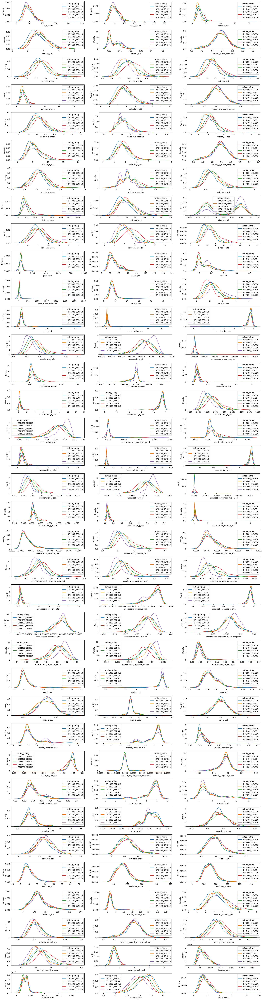

In [46]:
my_kdeplot(data_all, columns, 'setting_string')

## All mouse configurations

In [8]:
results_temp = my_friedman(data_all[data_all['task_id'] == data_all['task_id']], columns, 'setting_string', list(set().union(*[sensitivity_settings, dpi_settings])))
results_temp.significant.value_counts()

significant
True     95
False    13
Name: count, dtype: int64

In [9]:
results_temp = my_friedman(data_all[data_all['prototype_id'] == data_all['prototype_id']], columns, 'setting_string', list(set().union(*[sensitivity_settings, dpi_settings])))
results_temp.significant.value_counts()

significant
True     84
False    24
Name: count, dtype: int64